# clothes mask of 0.05

# add noise differently for clothes and for BG

# no loss mask

1500
steps

In [50]:
from huggingface_hub import notebook_login
notebook_login()

In [1]:
import diffusers
import transformers
import sys
import shutil
import time
from diffusers import StableDiffusionPipeline, StableDiffusionInpaintPipeline, StableDiffusionImg2ImgPipeline
import torch
import os
import random
import requests
from io import BytesIO
import numpy as np
import subprocess
from torchvision import models, transforms
import dlib
from PIL import Image, ImageFilter, ImageDraw, ImageEnhance
import cv2
from pathlib import Path
import math
import matplotlib.pyplot as plt

from scipy.ndimage import binary_closing
# from segment_anything import sam_model_registry, SamAutomaticMaskGenerator

# mediapipe
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision

device = "cuda" if torch.cuda.is_available() else "cpu"

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/25 [00:00<?, ?it/s]

/home/ubuntu/virtual_env_mask_exp/lib/python3.10/site-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

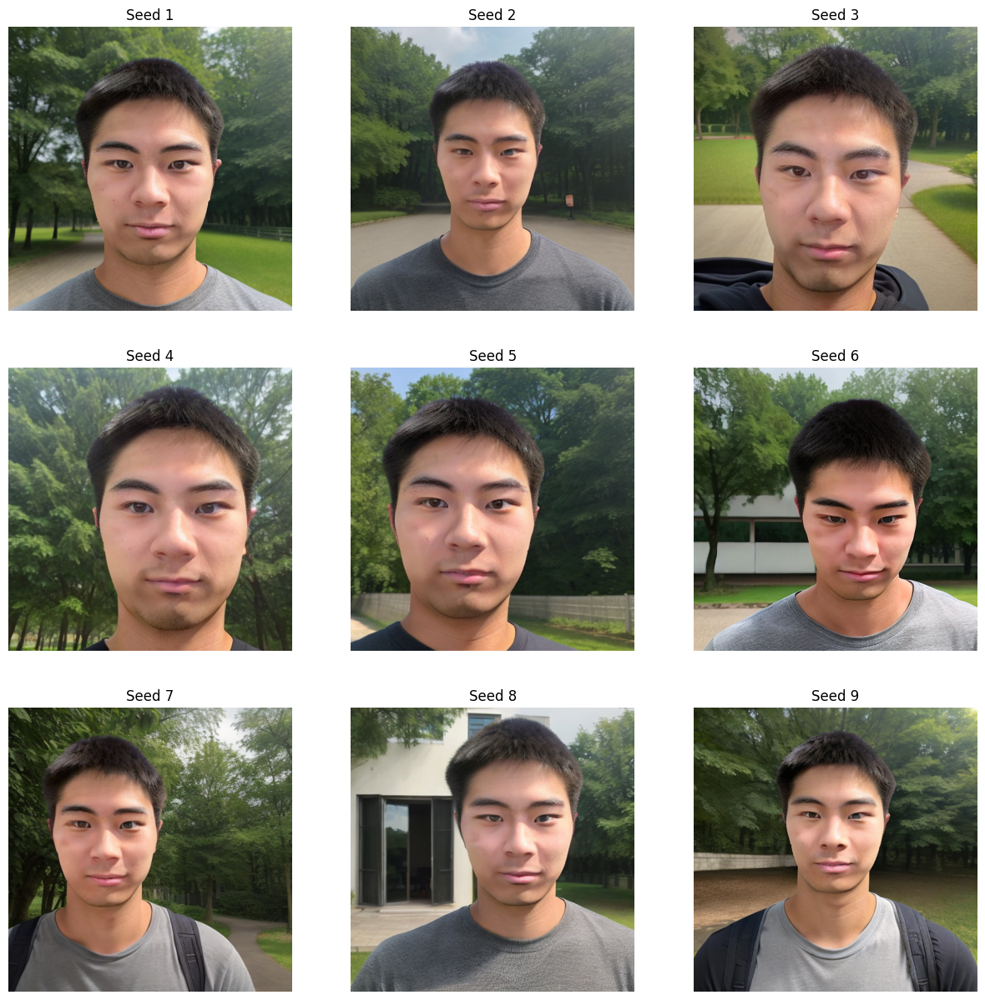

In [2]:
model_path = "ohmw_man_dreambooth"

pipe = StableDiffusionPipeline.from_pretrained(model_path)
pipe = pipe.to("cuda")

prompt = "photo of ohmw man outdoors"



num_images = 9

# 30 and 15 work
# for "hoto of ohmw man outdoors"

# larger steps (50-100)
# for something like: "photo of ohmw man in a suit outdoors"
# but this is because when training we weight the masked regions for the face and the body the same (1), maybe if we weighed it
# differently like 1 for face + skin and 0.5 for body then it could produce outputs with better faces
# and still somewhat resemble the body of the person
steps = 25

guidance_scale = 7.5



images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt=prompt,
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])
    
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

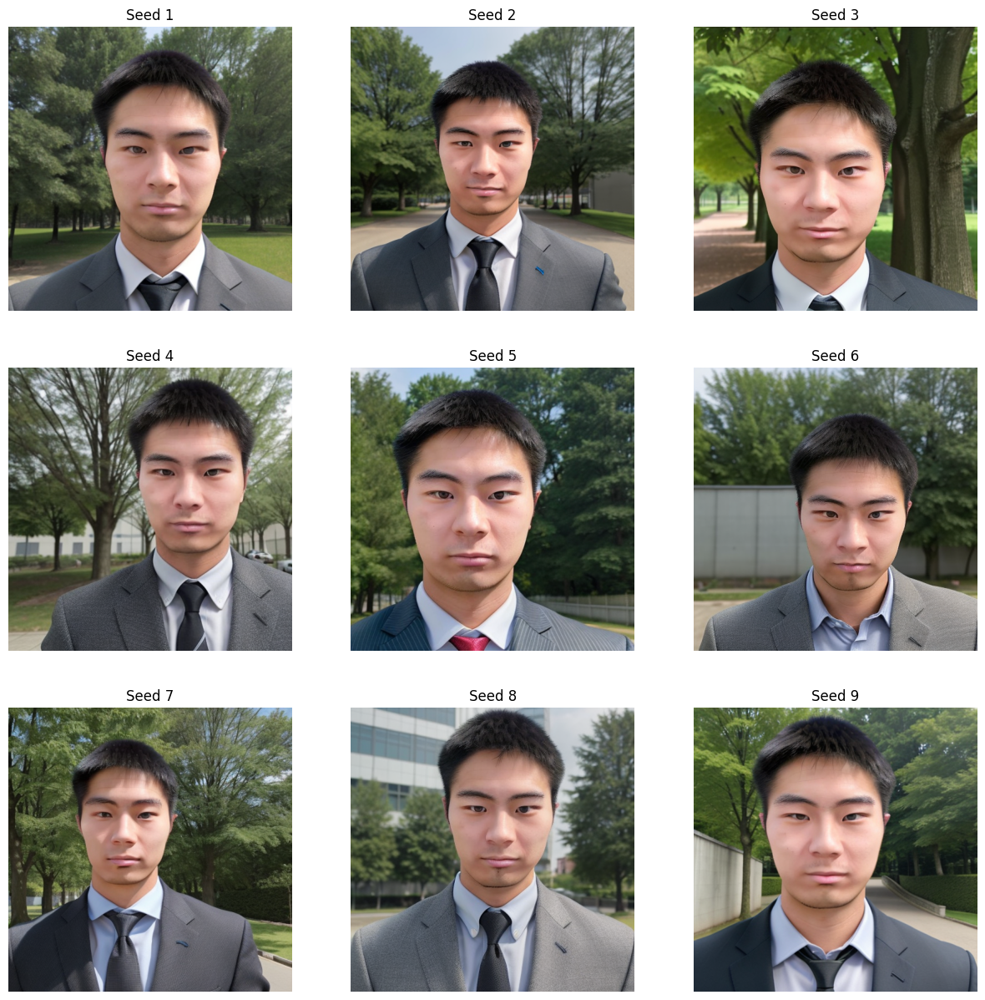

In [3]:
prompt = "photo of ohmw man in a suit outdoors"

num_images = 9
steps = 30

guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt=prompt,
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])

num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

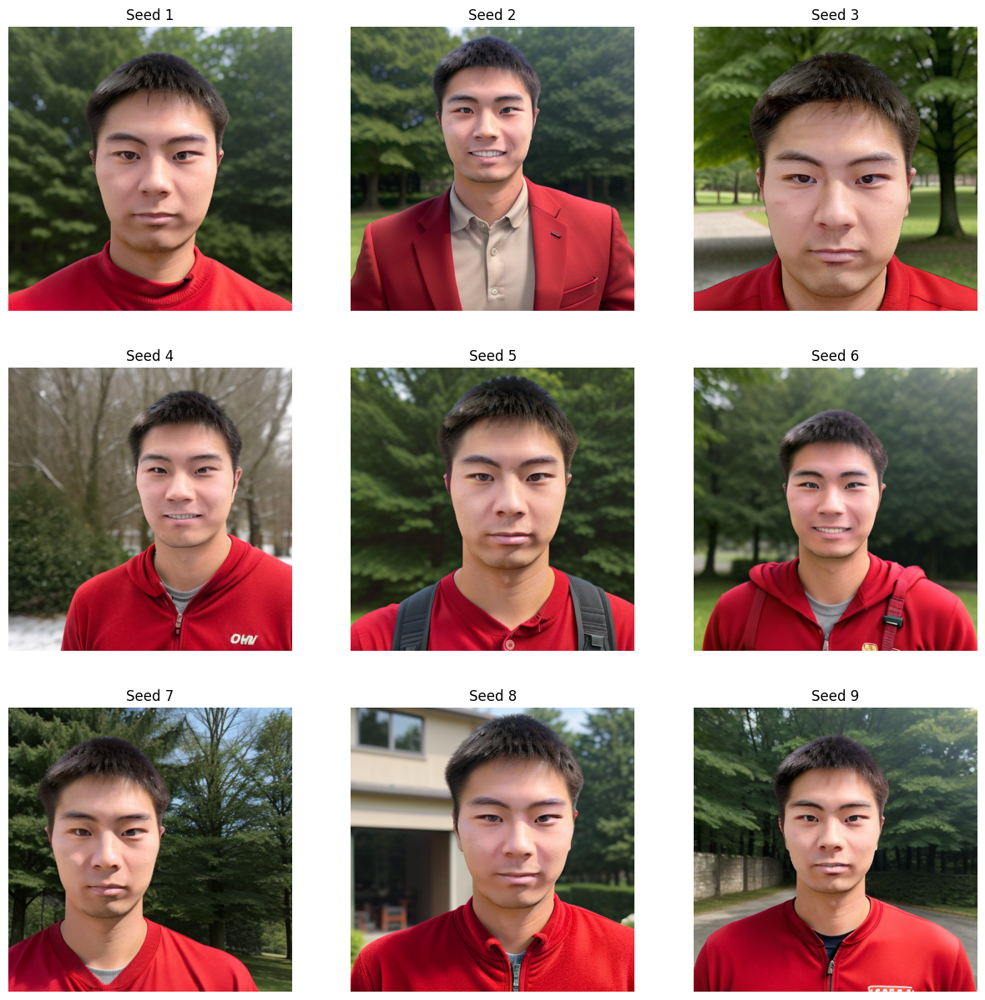

In [19]:
model_path = "ohmw_man_dreambooth"

pipe = StableDiffusionPipeline.from_pretrained(model_path)
pipe = pipe.to("cuda")


prompt = "a photo of ohwm man, outdoors, crisp detail, in a red suit,"

num_images = 9
steps = 30

guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt=prompt,
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])
    
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

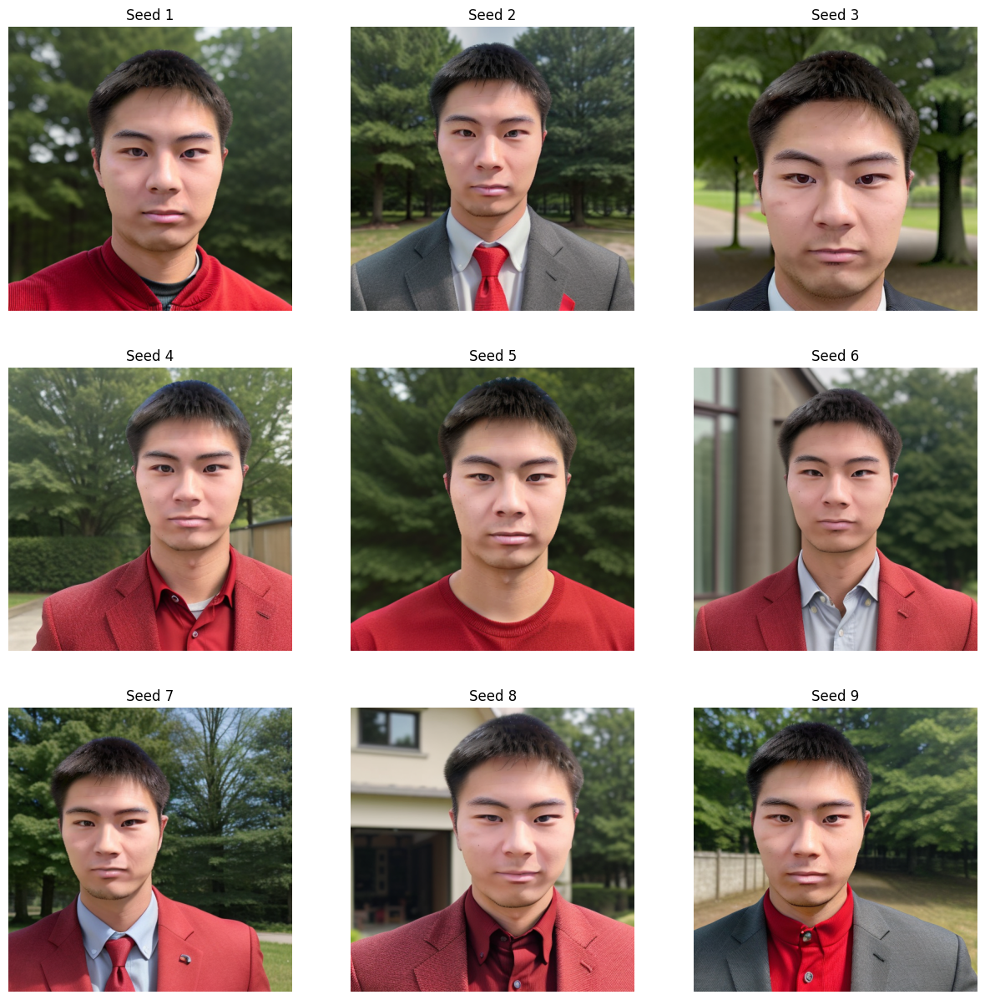

In [34]:
model_path = "ohmw_man_dreambooth"

pipe = StableDiffusionPipeline.from_pretrained(model_path)
pipe = pipe.to("cuda")


prompt = "a photo of ohwm man, outdoors, crisp detail, realistic, clothed in a red colored suit,"

num_images = 9
steps = 30

guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt=prompt,
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])
    
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

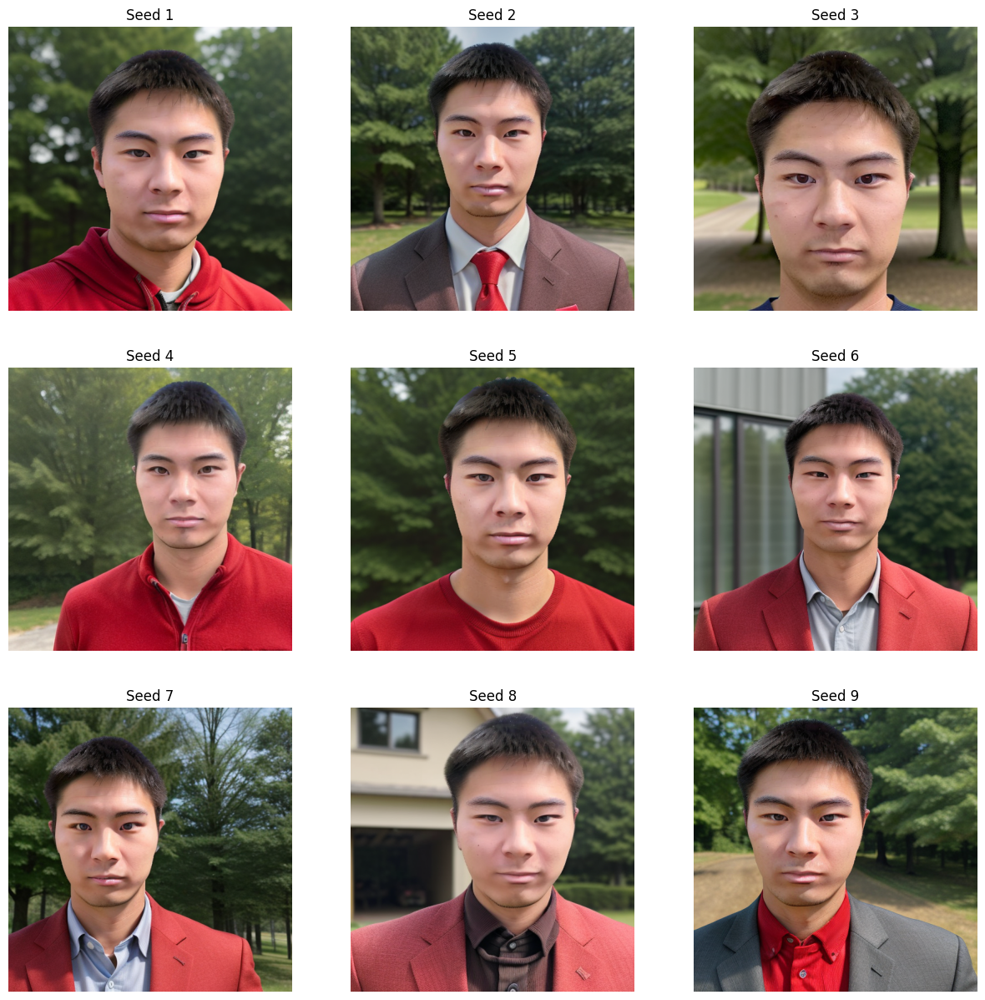

In [28]:
model_path = "ohmw_man_dreambooth"

pipe = StableDiffusionPipeline.from_pretrained(model_path)
pipe = pipe.to("cuda")


prompt = "a photo of ohwm man, outdoors, crisp detail, realistic, in a red colored suit,"

num_images = 9
steps = 25

guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt=prompt,
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])
    
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

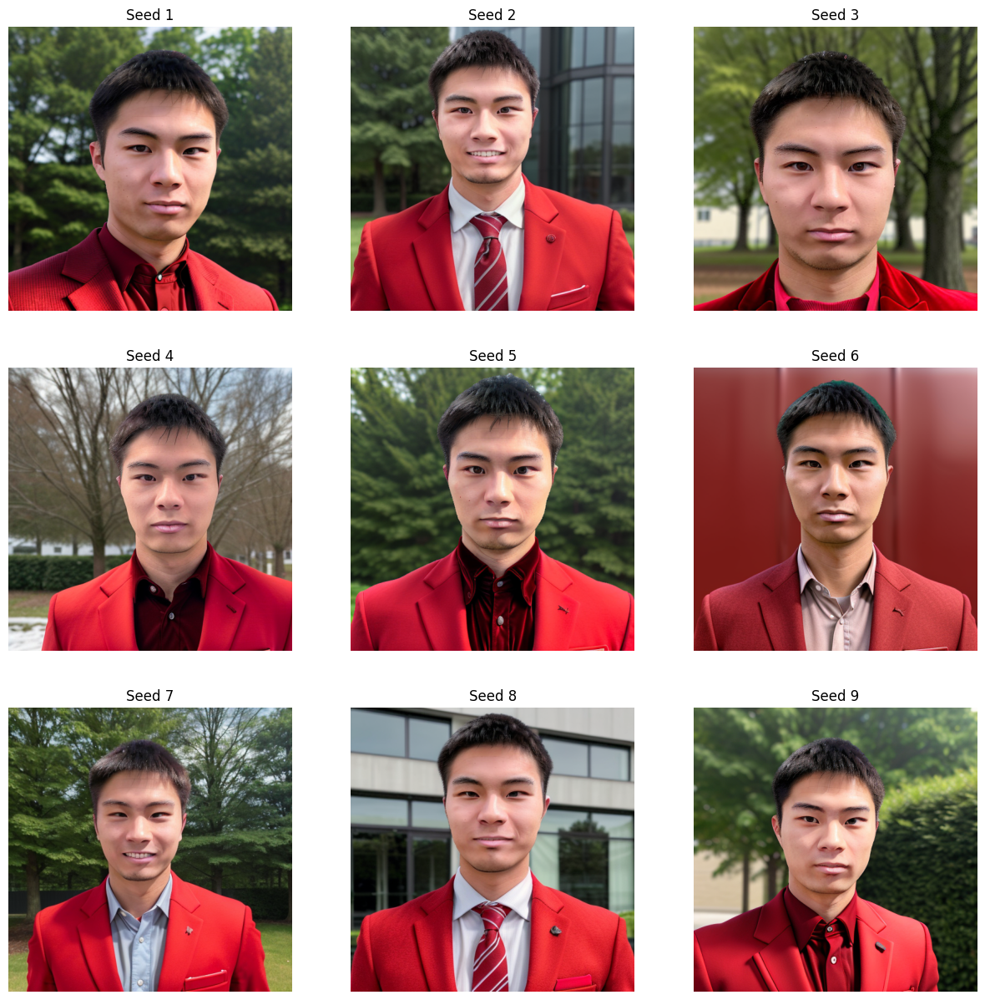

In [39]:
import torch
from diffusers import StableDiffusionPipeline
from compel import Compel
import matplotlib.pyplot as plt
import numpy as np
import math

# Load your DreamBooth-trained model
model_path = "ohmw_man_dreambooth"
pipe = StableDiffusionPipeline.from_pretrained(model_path).to("cuda")

# Initialize Compel with the tokenizer and text encoder from the pipeline
compel = Compel(tokenizer=pipe.tokenizer, text_encoder=pipe.text_encoder)

# Create a prompt with increased weight on the red suit
prompt = "a photo of ohwm man, outdoors, crisp detail, realistic, clothed in a red colored suit++"

# Build the conditioning tensor using Compel for the red suit emphasis
conditioning = compel.build_conditioning_tensor(prompt)

# Settings for multiple image generation
num_images = 9
steps = 30
guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt_embeds=conditioning,  # Use the Compel modified prompt embedding
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])

# Visualization of generated images
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

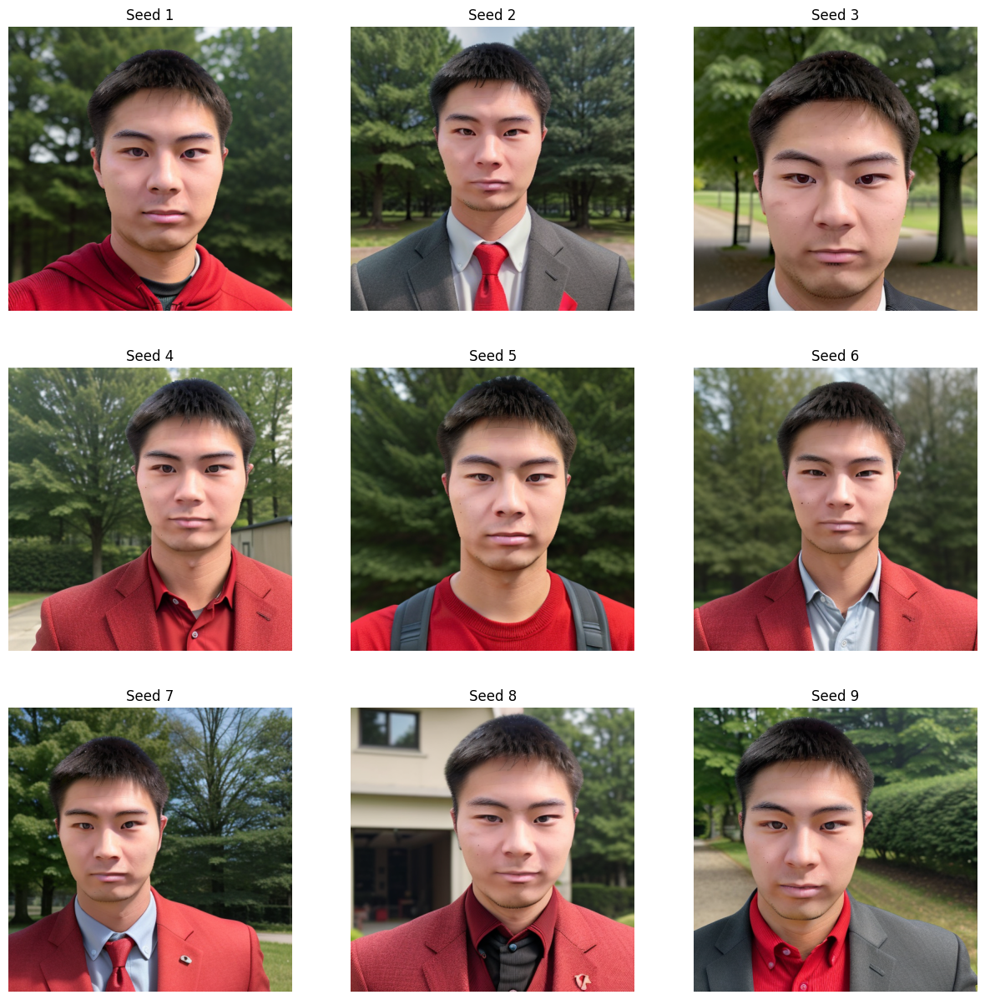

In [40]:
import torch
from diffusers import StableDiffusionPipeline
from compel import Compel
import matplotlib.pyplot as plt
import numpy as np
import math

# Load your DreamBooth-trained model
model_path = "ohmw_man_dreambooth"
pipe = StableDiffusionPipeline.from_pretrained(model_path).to("cuda")

# Initialize Compel with the tokenizer and text encoder from the pipeline
compel = Compel(tokenizer=pipe.tokenizer, text_encoder=pipe.text_encoder)

# Create a prompt with increased weight on the red suit
prompt = "a photo of ohwm man, outdoors, crisp detail, realistic, clothed in a red++ colored suit"

# Build the conditioning tensor using Compel for the red suit emphasis
conditioning = compel.build_conditioning_tensor(prompt)

# Settings for multiple image generation
num_images = 9
steps = 30
guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt_embeds=conditioning,  # Use the Compel modified prompt embedding
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])

# Visualization of generated images
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

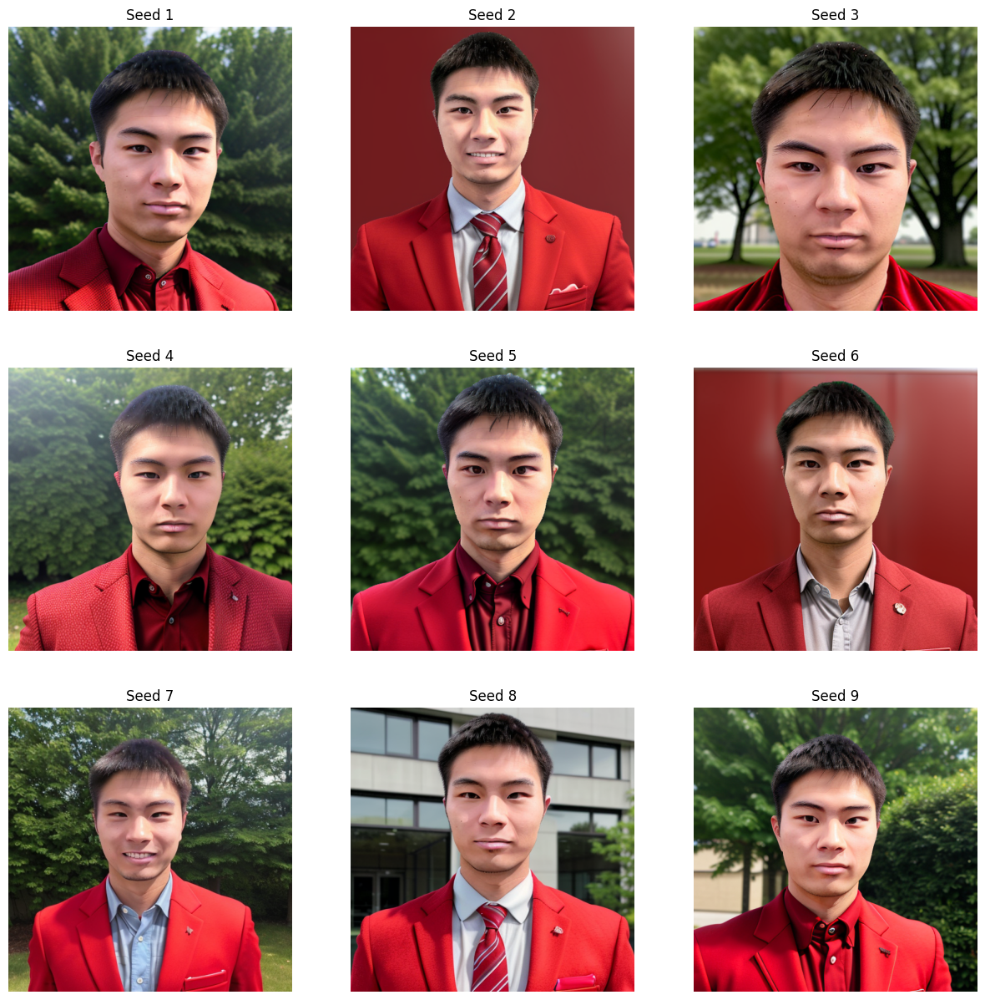

In [41]:
import torch
from diffusers import StableDiffusionPipeline
from compel import Compel
import matplotlib.pyplot as plt
import numpy as np
import math

# Load your DreamBooth-trained model
model_path = "ohmw_man_dreambooth"
pipe = StableDiffusionPipeline.from_pretrained(model_path).to("cuda")

# Initialize Compel with the tokenizer and text encoder from the pipeline
compel = Compel(tokenizer=pipe.tokenizer, text_encoder=pipe.text_encoder)

# Create a prompt with increased weight on the red suit
prompt = "a photo of ohwm++ man, outdoors, crisp detail, realistic, clothed in a red colored suit++"

# Build the conditioning tensor using Compel for the red suit emphasis
conditioning = compel.build_conditioning_tensor(prompt)

# Settings for multiple image generation
num_images = 9
steps = 30
guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt_embeds=conditioning,  # Use the Compel modified prompt embedding
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])

# Visualization of generated images
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

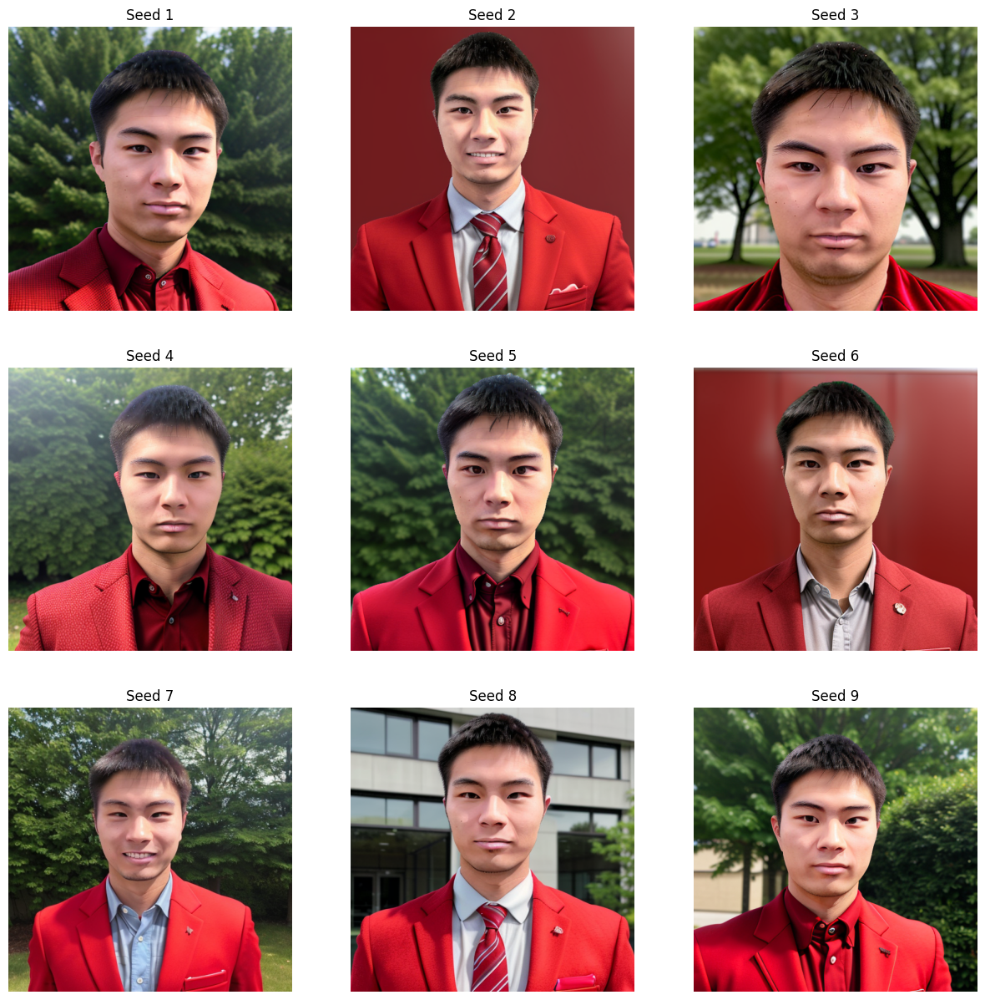

In [42]:
import torch
from diffusers import StableDiffusionPipeline
from compel import Compel
import matplotlib.pyplot as plt
import numpy as np
import math

# Load your DreamBooth-trained model
model_path = "ohmw_man_dreambooth"
pipe = StableDiffusionPipeline.from_pretrained(model_path).to("cuda")

# Initialize Compel with the tokenizer and text encoder from the pipeline
compel = Compel(tokenizer=pipe.tokenizer, text_encoder=pipe.text_encoder)

# Create a prompt with increased weight on the red suit
prompt = "a photo of ohwm++ man, outdoors, crisp detail, realistic, clothed in a red colored suit++"

# Build the conditioning tensor using Compel for the red suit emphasis
conditioning = compel.build_conditioning_tensor(prompt)

# Settings for multiple image generation
num_images = 9
steps = 30
guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt_embeds=conditioning,  # Use the Compel modified prompt embedding
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])

# Visualization of generated images
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

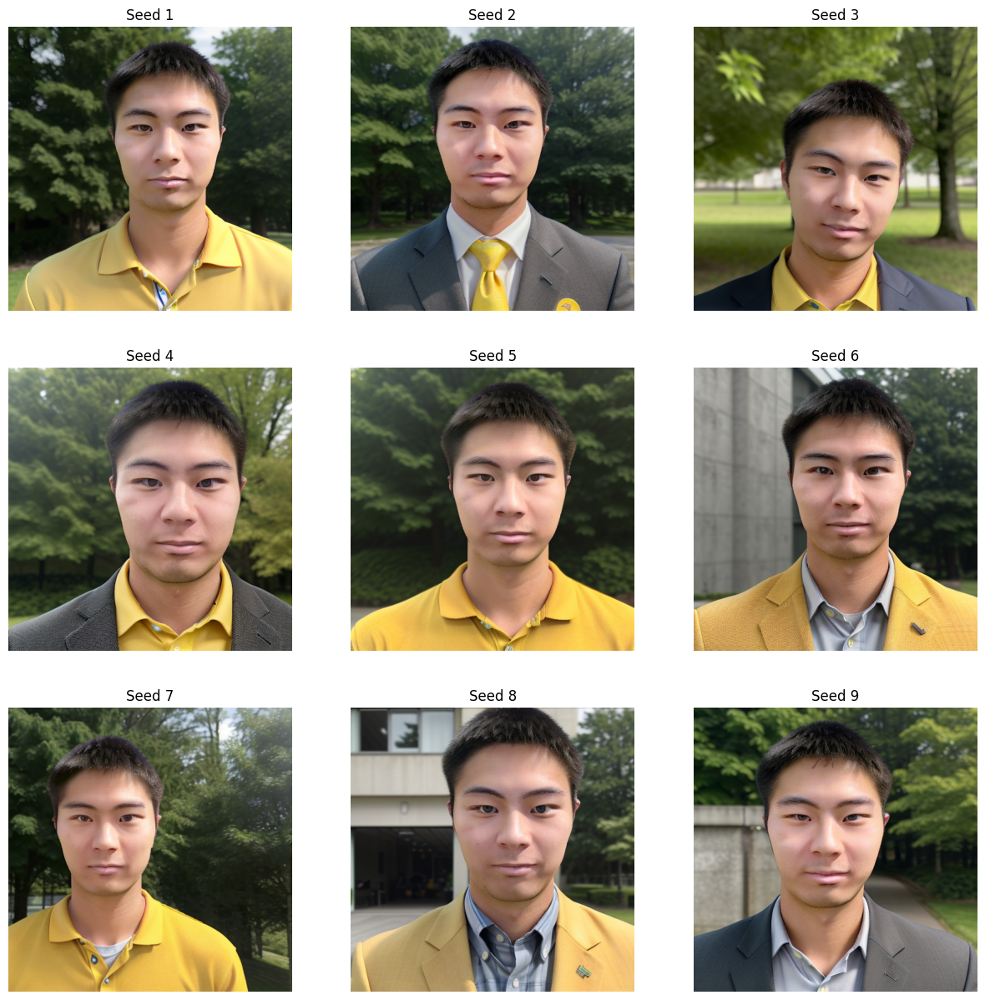

In [20]:
model_path = "ohmw_man_dreambooth"

pipe = StableDiffusionPipeline.from_pretrained(model_path)
pipe = pipe.to("cuda")


prompt = "a photo of ohwm man, crisp detail, outdoors, in a yellow colored suit"

num_images = 9
steps = 30

guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt=prompt,
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])
    
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

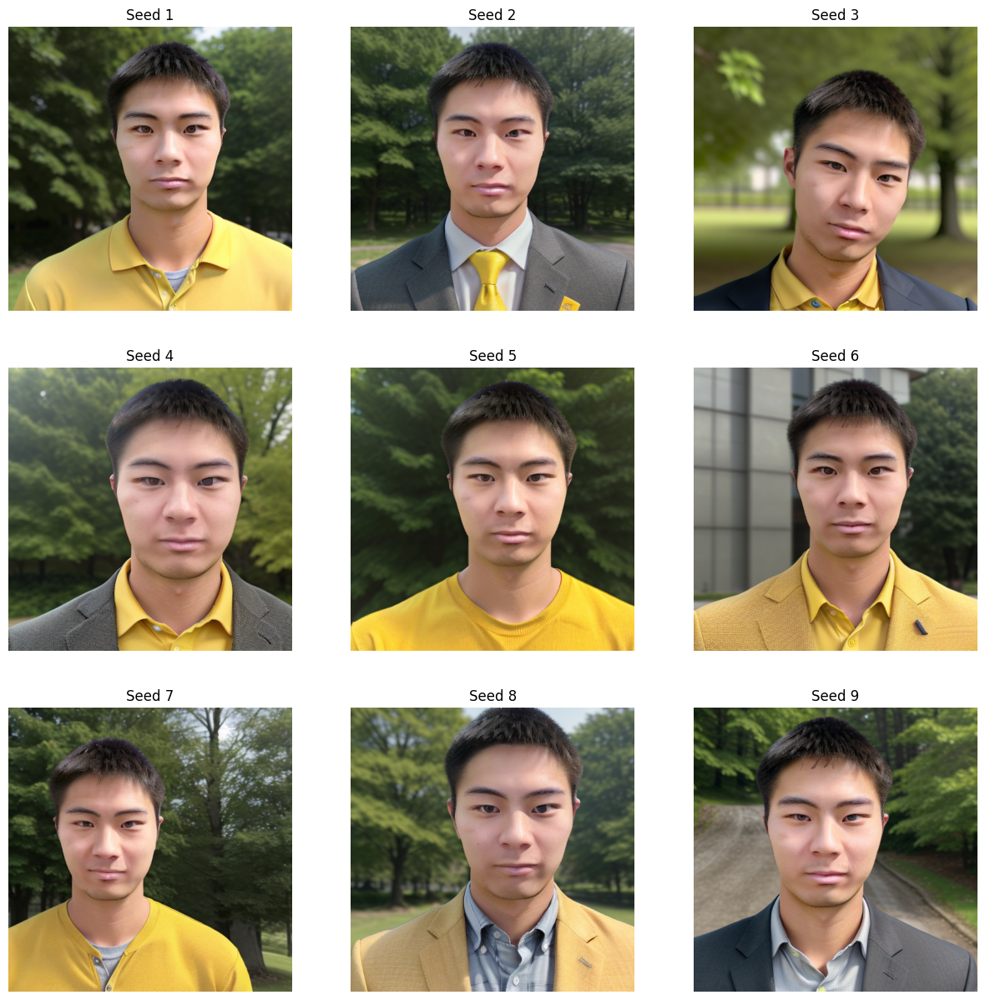

In [35]:
model_path = "ohmw_man_dreambooth"

pipe = StableDiffusionPipeline.from_pretrained(model_path)
pipe = pipe.to("cuda")


prompt = "a photo of ohwm man, outdoors, crisp detail, realistic, clothed in a yellow colored suit,"

num_images = 9
steps = 30

guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt=prompt,
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])
    
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

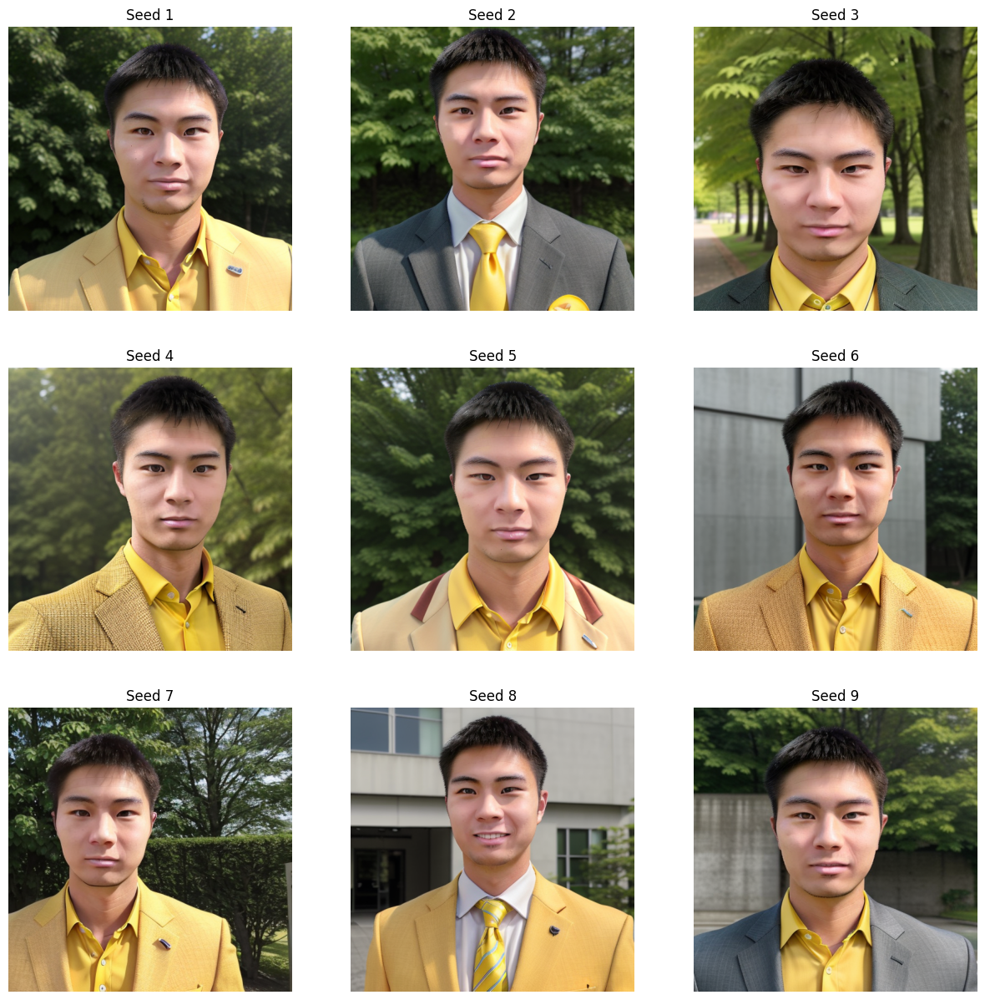

In [43]:
import torch
from diffusers import StableDiffusionPipeline
from compel import Compel
import matplotlib.pyplot as plt
import numpy as np
import math

# Load your DreamBooth-trained model
model_path = "ohmw_man_dreambooth"
pipe = StableDiffusionPipeline.from_pretrained(model_path).to("cuda")

# Initialize Compel with the tokenizer and text encoder from the pipeline
compel = Compel(tokenizer=pipe.tokenizer, text_encoder=pipe.text_encoder)

# Create a prompt with increased weight on the red suit
prompt = "a photo of ohwm man, outdoors, crisp detail, realistic, clothed in a yellow colored suit++"

# Build the conditioning tensor using Compel for the red suit emphasis
conditioning = compel.build_conditioning_tensor(prompt)

# Settings for multiple image generation
num_images = 9
steps = 30
guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt_embeds=conditioning,  # Use the Compel modified prompt embedding
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])

# Visualization of generated images
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

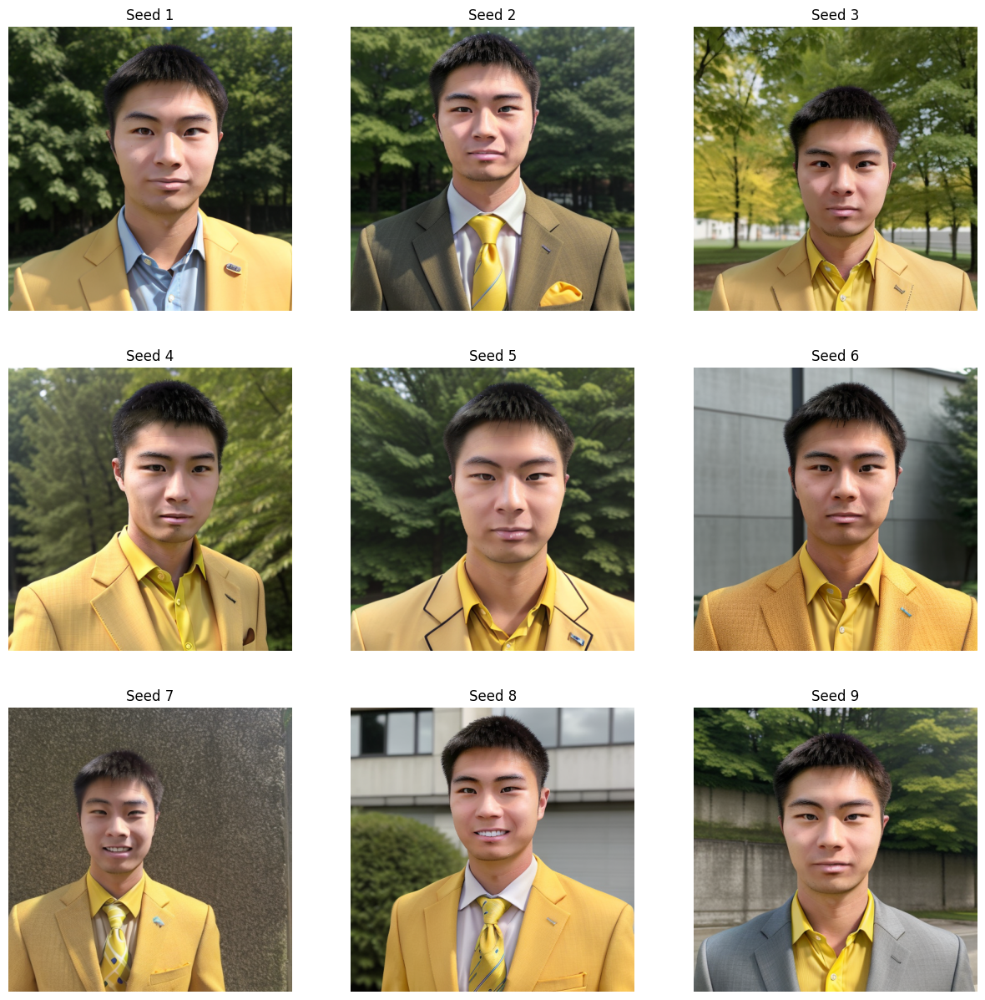

In [44]:
import torch
from diffusers import StableDiffusionPipeline
from compel import Compel
import matplotlib.pyplot as plt
import numpy as np
import math

# Load your DreamBooth-trained model
model_path = "ohmw_man_dreambooth"
pipe = StableDiffusionPipeline.from_pretrained(model_path).to("cuda")

# Initialize Compel with the tokenizer and text encoder from the pipeline
compel = Compel(tokenizer=pipe.tokenizer, text_encoder=pipe.text_encoder)

# Create a prompt with increased weight on the red suit
prompt = "a photo of ohwm man, outdoors, crisp detail, in a yellow colored suit++"

# Build the conditioning tensor using Compel for the red suit emphasis
conditioning = compel.build_conditioning_tensor(prompt)

# Settings for multiple image generation
num_images = 9
steps = 30
guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt_embeds=conditioning,  # Use the Compel modified prompt embedding
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])

# Visualization of generated images
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

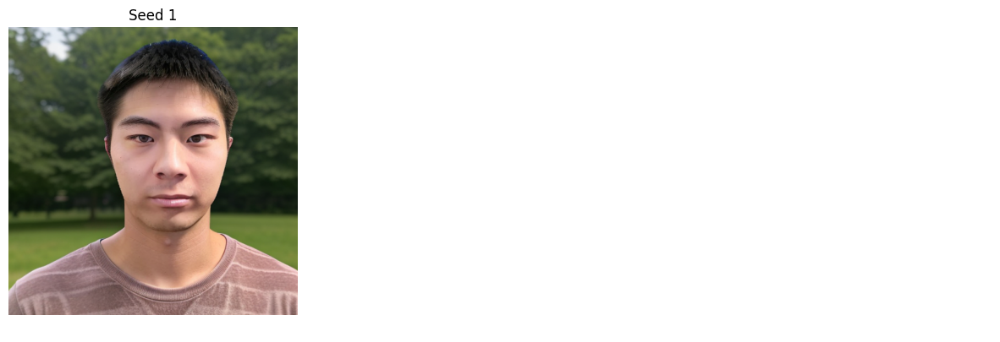

In [36]:
model_path = "ohmw_man_dreambooth"

pipe = StableDiffusionPipeline.from_pretrained(model_path)
pipe = pipe.to("cuda")


prompt = "a photo of ohwm man, outdoors, crisp detail, realistic, clothed in pajamas"

num_images = 1
steps = 30

guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt=prompt,
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed + 4),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])
    
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/25 [00:00<?, ?it/s]

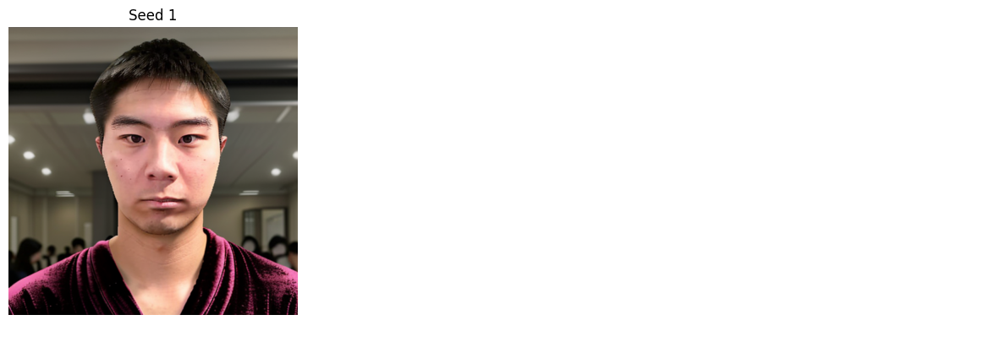

In [38]:
model_path = "ohmw_man_dreambooth"

pipe = StableDiffusionPipeline.from_pretrained(model_path)
pipe = pipe.to("cuda")


prompt = "a photo of ohwm man, in New York City, crisp detail, realistic, clothed in a robe"

num_images = 1
steps = 25

guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt=prompt,
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed + 4),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])
    
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

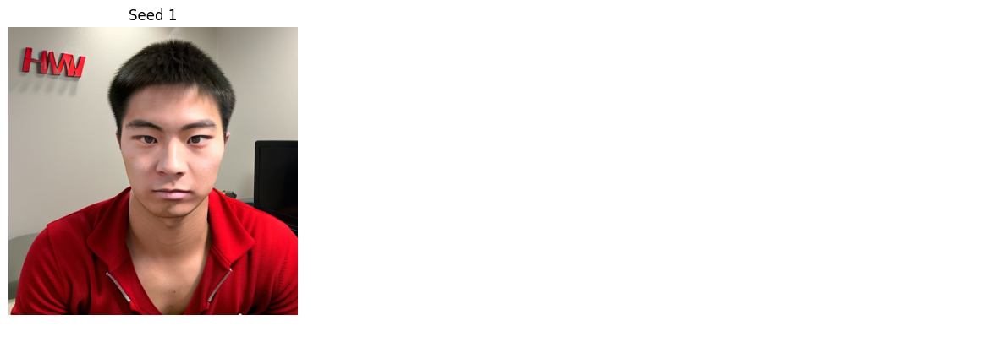

In [8]:
model_path = "ohmw_man_dreambooth"

pipe = StableDiffusionPipeline.from_pretrained(model_path)
pipe = pipe.to("cuda")


prompt = "ohmw man wearing a red suit"

num_images = 1
steps = 30

guidance_scale = 10

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt=prompt,
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed + 10),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])
    
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

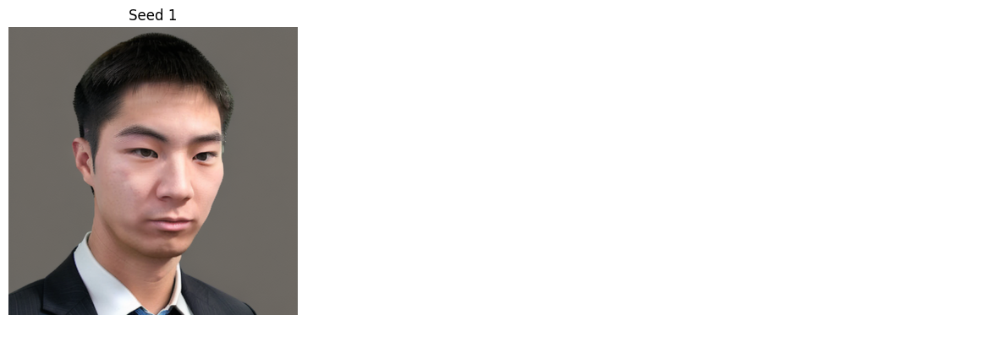

In [9]:
model_path = "ohmw_man_dreambooth"

pipe = StableDiffusionPipeline.from_pretrained(model_path)
pipe = pipe.to("cuda")


prompt = "ohmw man wearing a suit"

num_images = 1
steps = 30

guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt=prompt,
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed + 4),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])
    
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

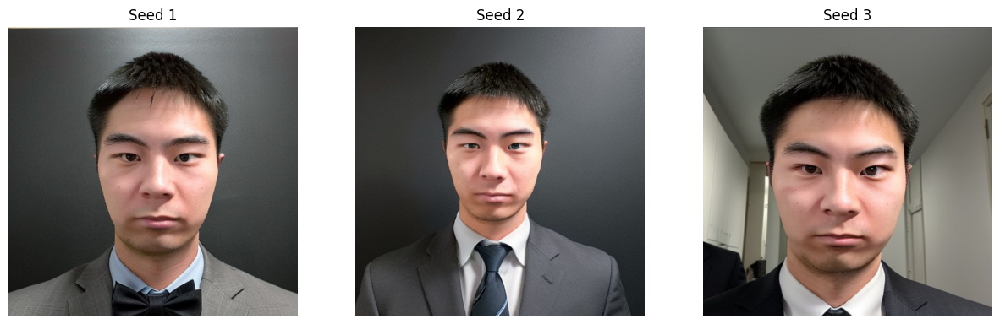

In [10]:
model_path = "ohmw_man_dreambooth"

pipe = StableDiffusionPipeline.from_pretrained(model_path)
pipe = pipe.to("cuda")


prompt = "photo of ohmw man in a suit in New York"

num_images = 3
steps = 30

guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt=prompt,
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])

num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()

# Looks like "outdoors" needs to be included for some reason

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

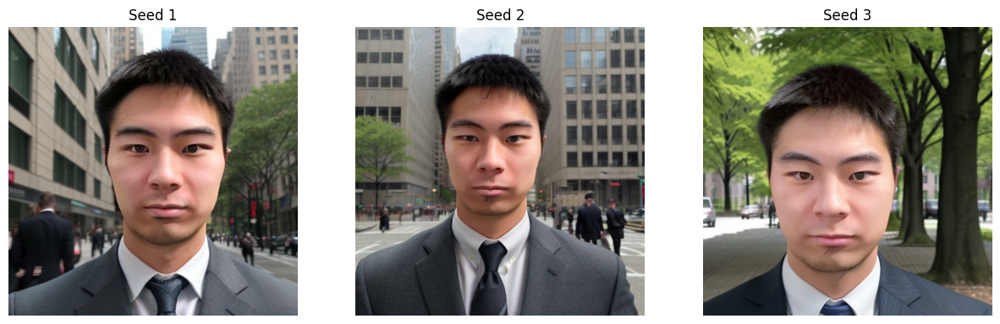

In [11]:
model_path = "ohmw_man_dreambooth"

pipe = StableDiffusionPipeline.from_pretrained(model_path)
pipe = pipe.to("cuda")


prompt = "photo of ohmw man in a suit outdoors in New York"

num_images = 3
steps = 30

guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt=prompt,
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])

num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

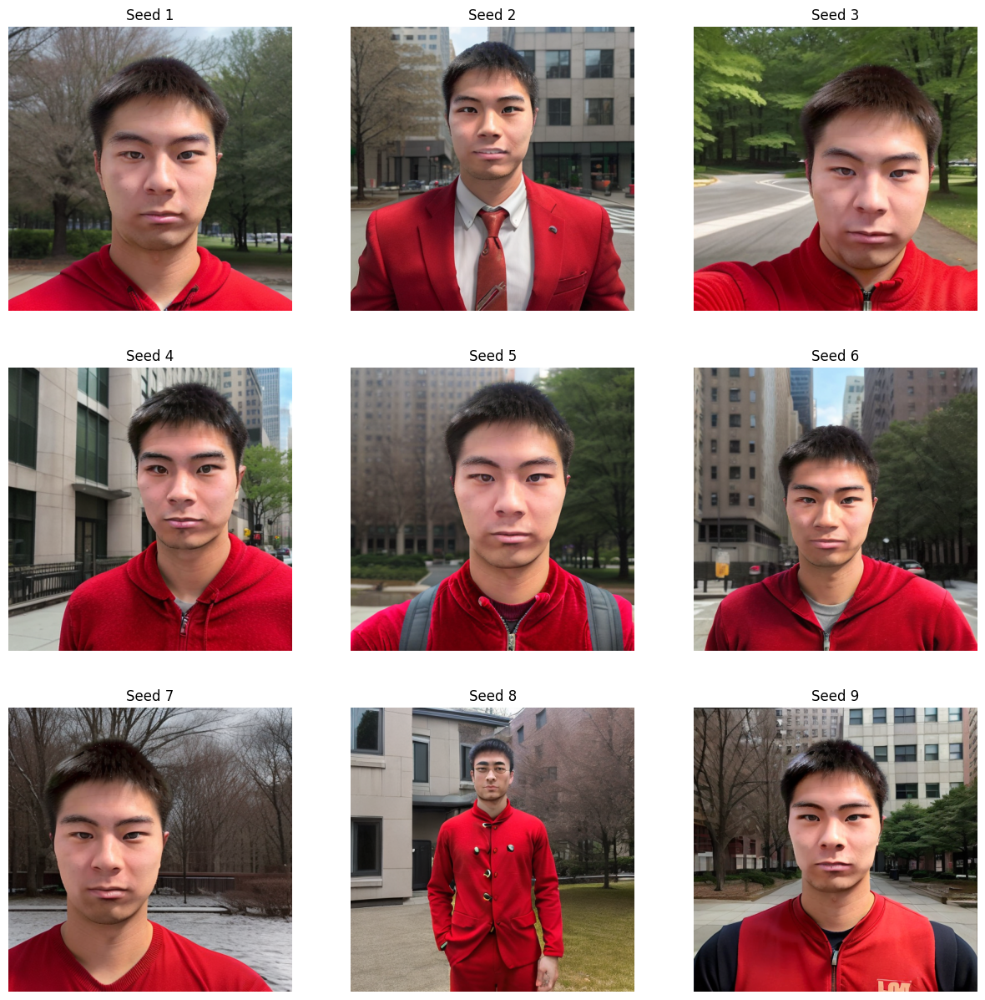

In [12]:
model_path = "ohmw_man_dreambooth"

pipe = StableDiffusionPipeline.from_pretrained(model_path)
pipe = pipe.to("cuda")


prompt = "photo of ohmw man, outdoors New York, in a red suit"

num_images = 9
steps = 25

guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt=prompt,
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])

num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

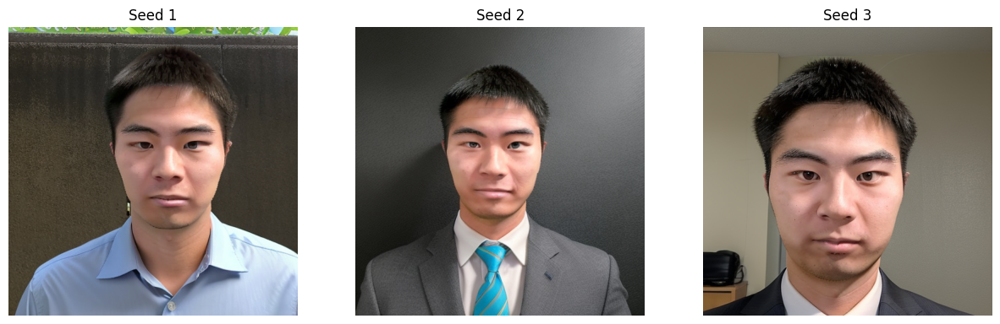

In [13]:
model_path = "ohmw_man_dreambooth"

pipe = StableDiffusionPipeline.from_pretrained(model_path)
pipe = pipe.to("cuda")


prompt = "photo of ohmw man in a suit in hawaii"

num_images = 3
steps = 30

guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt=prompt,
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])

num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

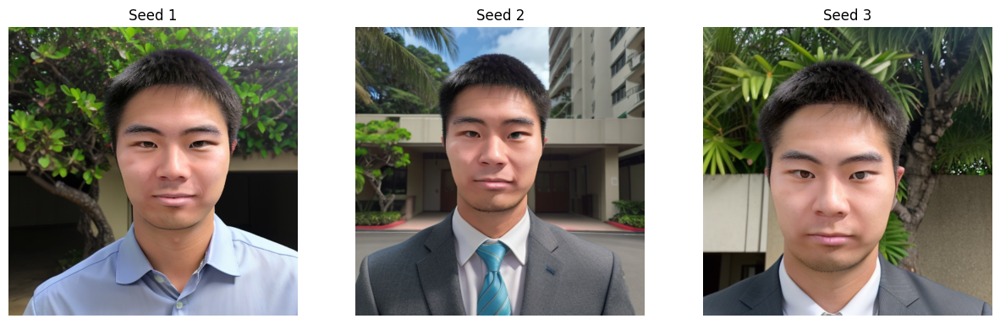

In [14]:
model_path = "ohmw_man_dreambooth"

pipe = StableDiffusionPipeline.from_pretrained(model_path)
pipe = pipe.to("cuda")


prompt = "photo of ohmw man in a suit outdoors in hawaii"

num_images = 3
steps = 30

guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt=prompt,
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])

num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()

In [15]:
# prompt = "photo of ohmw man outdoors"
# steps = 15
# guidance_scale = 3.5


# test_image = pipe(prompt=prompt,
#         num_inference_steps=steps,
#         guidance_scale=guidance_scale,
#         generator=torch.Generator("cuda").manual_seed(1),
#         width=512,
#         height=512,
#         strength=1.0).images[0]

# test_image.save("output_image.jpg")
# test_image.show()

# Im2Im

But lets make it our BG image

In [16]:

model_path = "ohmw_man_dreambooth"
pipe = StableDiffusionImg2ImgPipeline.from_pretrained(model_path)
pipe = pipe.to("cuda")

input_image_path = "output_image.jpg"
input_image = Image.open(input_image_path).convert("RGB")


prompt = "A photo of ohmw in a suit outdoors"
num_inference_steps = 30
guidance_scale = 4

output_images = pipe(
    prompt=prompt,
    init_image=input_image,
    generator=torch.Generator("cuda").manual_seed(1),
    num_inference_steps=num_inference_steps,
    guidance_scale=guidance_scale,
)

generated_image = output_images.images[0]
generated_image.show()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_img2img.StableDiffusionImg2ImgPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


FileNotFoundError: [Errno 2] No such file or directory: '/home/ubuntu/mask_experiment/output_image.jpg'

In [2]:
import torch
from diffusers import StableDiffusionPipeline
from compel import Compel
import matplotlib.pyplot as plt
import numpy as np
import math

# Load your DreamBooth-trained model
model_path = "ohmw_man_dreambooth"
pipe = StableDiffusionPipeline.from_pretrained(model_path).to("cuda")

# Initialize Compel with the tokenizer and text encoder from the pipeline
compel = Compel(tokenizer=pipe.tokenizer, text_encoder=pipe.text_encoder)

# Create a prompt with increased weight on the red suit
prompt = "a photo of ohwm man, outdoors, crisp detail, realistic, clothed in a red colored suit++"

# Build the conditioning tensor using Compel for the red suit emphasis
conditioning = compel.build_conditioning_tensor(prompt)

# Settings for multiple image generation
num_images = 1
steps = 30
guidance_scale = 7.5

images = []
for seed in range(1, num_images + 1):
    result = pipe(
        prompt_embeds=conditioning,  # Use the Compel modified prompt embedding
        num_inference_steps=steps,
        generator=torch.Generator("cuda").manual_seed(seed),
        width=512,
        height=512,
        strength=1.0,
        guidance_scale=guidance_scale,
    )
    images.append(result.images[0])

# Visualization of generated images
num_images = len(images)
rows = math.ceil(num_images / 3)
fig, axs = plt.subplots(rows, 3, figsize=(15, 5 * rows))
if num_images <= 3:
    axs = np.array([axs])
for i, img in enumerate(images):
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.set_title(f"Seed {i+1}")
    ax.axis('off')
for j in range(i + 1, rows * 3):
    axs[j // 3, j % 3].axis('off')
plt.show()


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


OutOfMemoryError: CUDA out of memory. Tried to allocate 114.00 MiB. GPU 

In [ ]:
import torch
from torchvision import models, transforms
from PIL import Image, ImageDraw
import numpy as np
import cv2

image = result.images[0]

# OpenCV for face detection
image_cv = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
faces = face_cascade.detectMultiScale(image_cv, 1.1, 4)

x, y, w, h = faces[0]
margin = 30
x, y, w, h = max(0, x-margin), max(0, y-margin), w+2*margin, h+2*margin

# Crop the face area for segmentation
face_area = image.crop((x, y, x+w, y+h))

model = models.segmentation.deeplabv3_resnet101(pretrained=True)
model.eval()

preprocess = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

input_tensor = preprocess(face_area).unsqueeze(0)
with torch.no_grad():
    output = model(input_tensor)['out'][0]
output_predictions = output.argmax(0)


mask = output_predictions.byte().cpu().numpy()
face_mask = Image.fromarray(mask * 255)

#resize
resized_face_area = face_area.resize((512, 512))
resized_mask = face_mask.resize((512, 512))




from PIL import ImageFilter
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision


resized_face_area_np = np.array(resized_face_area)

# Ensure the image is in uint8 format
if resized_face_area_np.dtype != np.uint8:
    resized_face_area_np = resized_face_area_np.astype(np.uint8)

mp_image = mp.Image(image_format=mp.ImageFormat.SRGB, data=resized_face_area_np)

model_path = 'selfie_multiclass_256x256.tflite'
options = vision.ImageSegmenterOptions(
    base_options=mp.tasks.BaseOptions(model_asset_path=model_path),
    running_mode=vision.RunningMode.IMAGE,
    output_category_mask=True
)


with vision.ImageSegmenter.create_from_options(options) as segmenter:
    segmentation_result = segmenter.segment(mp_image)
    category_mask = segmentation_result.category_mask

    category_names = {
        0: 'Background',
        1: 'Hair',
        2: 'BodySkin',
        3: 'FaceSkin',
        4: 'Clothes',
    }
    category_mask_np = segmentation_result.category_mask.numpy_view()
    unique_categories = np.unique(category_mask_np)


face_mask = ((category_mask_np == 1) | (category_mask_np == 3))

processed_mask = binary_closing(face_mask, structure=np.ones((3, 3)))
person_mask_image = Image.fromarray((processed_mask * 255).astype(np.uint8))

padding_size = 10
blur_radius = 3
padded_mask_image = Image.new('L', (person_mask_image.width + 2 * padding_size,
                                    person_mask_image.height + 2 * padding_size), color=0)
padded_mask_image.paste(person_mask_image, (padding_size, padding_size))
blurred_mask_image = padded_mask_image.filter(ImageFilter.GaussianBlur(blur_radius))




plt.figure(figsize=(2, 5))
plt.imshow(blurred_mask_image, cmap='gray')
plt.title("Face")
plt.axis('off')
plt.show()

In [ ]:
checkpoint_path = "ohmw_man_dreambooth"

dreamboothPipeline = StableDiffusionInpaintPipeline.from_pretrained(
    checkpoint_path,
).to("cuda" if torch.cuda.is_available() else "cpu")

output = dreamboothPipeline(
    prompt="photo of ohmw man professional",
    image=resized_face_area,
    mask_image=blurred_mask_image,
    num_inference_steps=30,
    strength=0.6,
    guidance_scale=4,
)

inpainted_face_large = output.images[0]
inpainted_face_large.show()